In [1]:
import random

import cv2
from matplotlib import pyplot as plt

import albumentations as A

In [2]:
BOX_COLOR = (255, 0, 0) # Red
TEXT_COLOR = (255, 255, 255) # White

def visualize_bbox(img, bbox, class_name, color=BOX_COLOR, thickness=2,format='coco'):
    """Visualizes a single bounding box on the image"""
    x_min, y_min, w, h = 0,0,0,0
    if format == 'yolo':
        img_w,img_h = img.shape[1],img.shape[0]
        c_x = bbox[0] * img_w
        c_y = bbox[1] * img_h
        box_w = bbox[2] * img_w
        box_h = bbox[3] * img_h

        x_min = c_x - box_w/2
        y_min = c_y - box_h/2
        w,h = box_w,box_h
    elif format == 'coco':
        x_min, y_min, w, h = bbox
    
    x_min, x_max, y_min, y_max = int(x_min), int(x_min + w), int(y_min), int(y_min + h)
   
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)
    
    ((text_width, text_height), _) = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.35, 1)    
    cv2.rectangle(img, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), BOX_COLOR, -1)
    cv2.putText(
        img,
        text=class_name,
        org=(x_min, y_min - int(0.3 * text_height)),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.35, 
        color=TEXT_COLOR, 
        lineType=cv2.LINE_AA,
    )
    return img


def visualize(image, bboxes, category_ids, category_id_to_name,format='coco'):
    img = image.copy()
    for bbox, category_id in zip(bboxes, category_ids):
        class_name = category_id_to_name[category_id]
        img = visualize_bbox(img, bbox, class_name,format=format)
    plt.figure(figsize=(12, 12))
    plt.axis('off')
    plt.imshow(img)

In [3]:
def parse_yolo_label(label_file):
    f_origin = open(label_file)
    lines = f_origin.readlines()
    bboxes = []
    class_ids = []
    for l in lines:
        c = l.rstrip('\n').split(' ') #c means content
        
        class_index = c[0]
        (x_ratio,y_ratio,w_ratio,h_ratio) = (float(x) for x in c[1:])

        bboxes.append([x_ratio,y_ratio,w_ratio,h_ratio])
        class_ids.append(int(class_index))

    f_origin.close()

    print(bboxes,class_ids)
    return (bboxes,class_ids)

# parse_yolo_label('/media/sc/unitek/data/lishui_lights/23262brightness0.txt')

[[0.788194, 0.400926, 0.00972222, 0.0259259], [0.763889, 0.402778, 0.00902778, 0.0287037], [0.715972, 0.400926, 0.00902778, 0.025]] [1, 1, 1]
[[0.788194, 0.400926, 0.00972222, 0.0259259], [0.763889, 0.402778, 0.00902778, 0.0287037], [0.715972, 0.400926, 0.00902778, 0.025]]
[[0.231944, 0.62963, 0.00833333, 0.0277778], [0.257639, 0.631481, 0.00763889, 0.0240741], [0.309028, 0.631481, 0.00694444, 0.025]] [0, 0, 1]
[[0.231944, 0.62963, 0.00833333, 0.0277778], [0.257639, 0.631481, 0.00763889, 0.0240741], [0.309028, 0.631481, 0.00694444, 0.025]]
[[0.283333, 0.585185, 0.0138889, 0.0435185], [0.325, 0.591667, 0.0131944, 0.0407407], [0.409722, 0.590741, 0.0138889, 0.0398148]] [0, 0, 1]
[[0.283333, 0.585185, 0.0138889, 0.0435185], [0.325, 0.591667, 0.0131944, 0.0407407], [0.409722, 0.590741, 0.0138889, 0.0398148]]
[[0.231944, 0.62963, 0.008333, 0.027778], [0.257986, 0.631481, 0.007639, 0.024074], [0.309028, 0.631944, 0.006944, 0.025]] [0, 0, 1]
[[0.231944, 0.62963, 0.008333, 0.027778], [0.257986

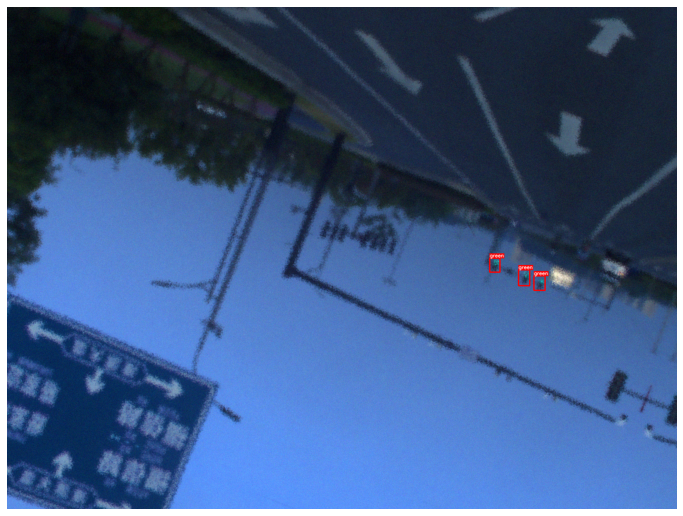

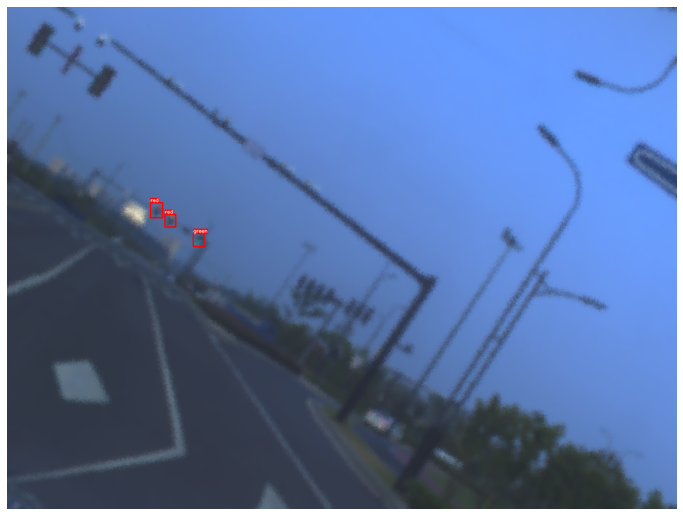

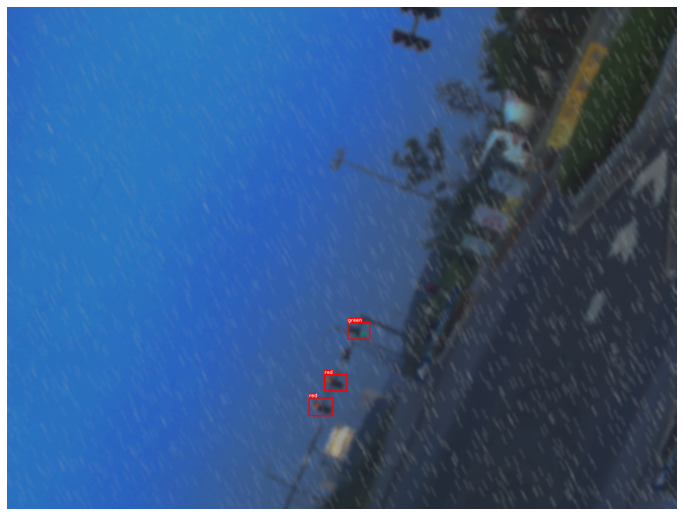

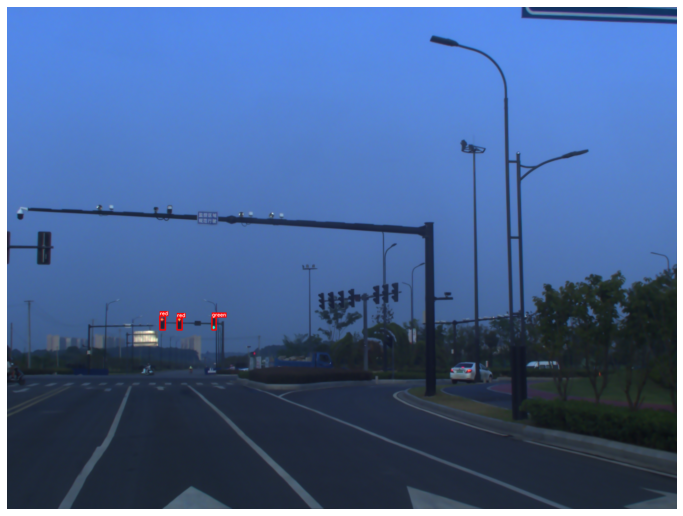

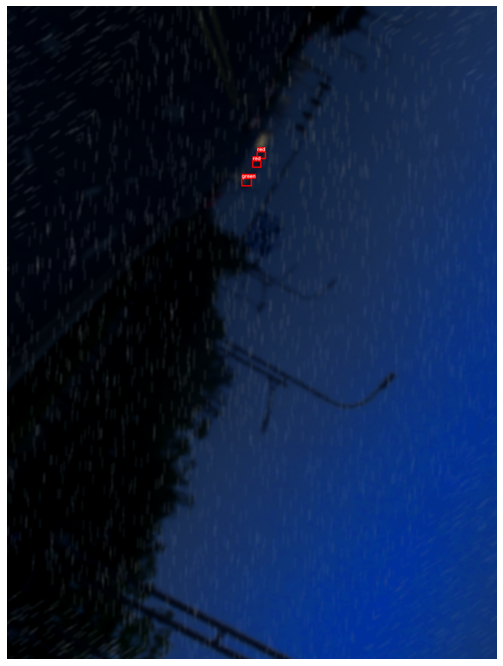

...

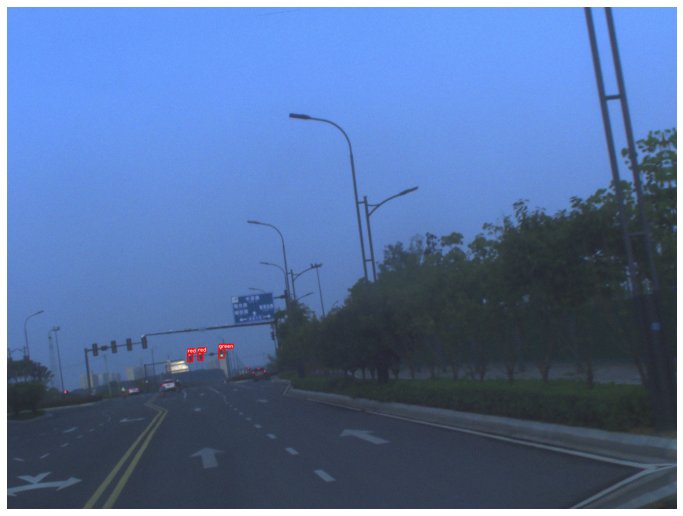

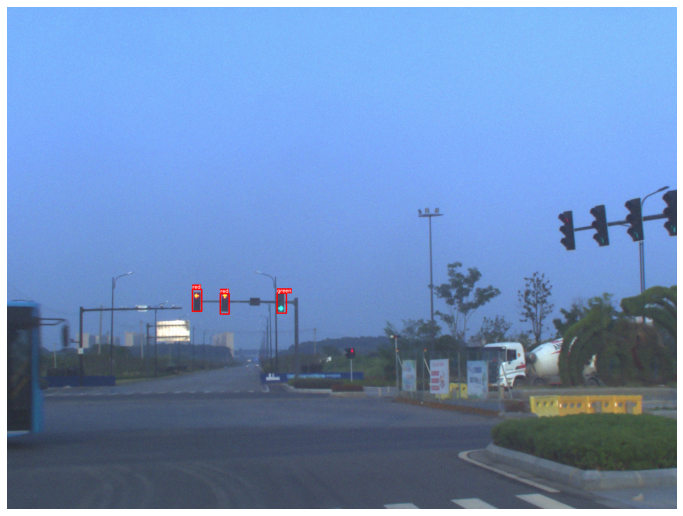

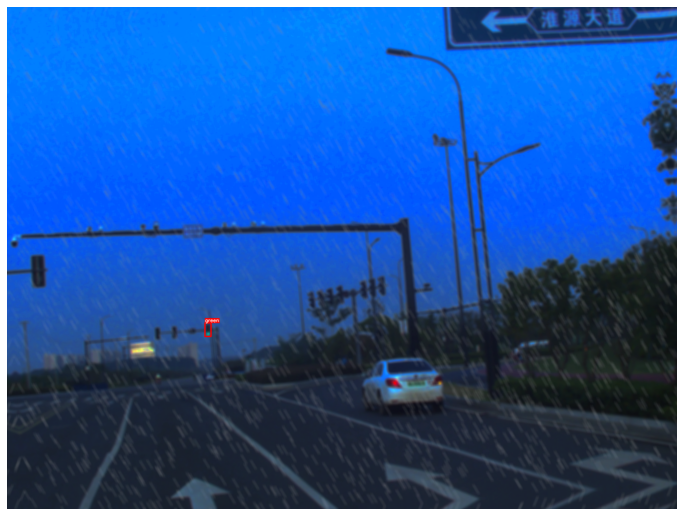

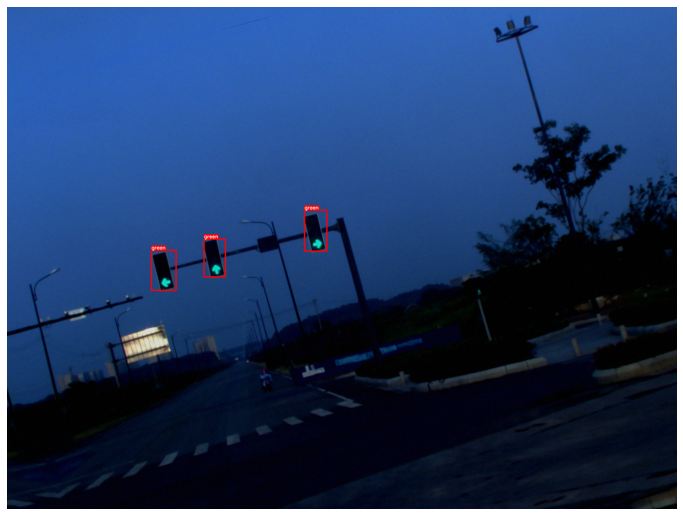

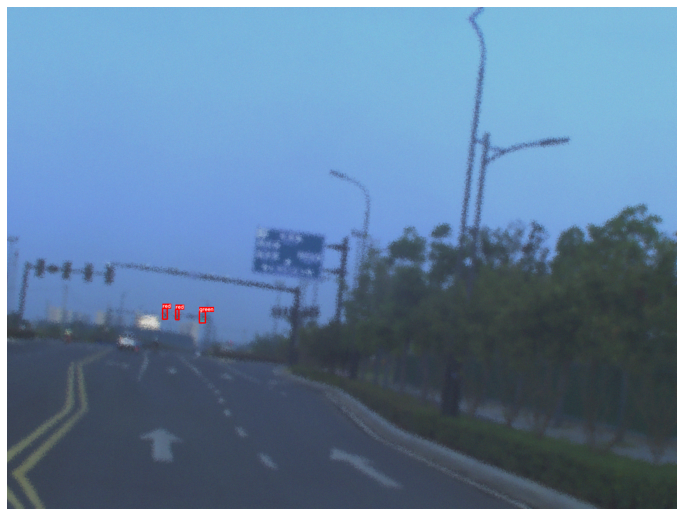

In [19]:
import os
category_id_to_name = {0:'red',1:"green"}

#定义变换
transform = A.Compose([
    # A.RandomCrop(),
    # A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.6),
    # A.RandomRotate90(),
    A.Rotate(limit=25,p=0.2), #限制旋转角度为25度
    A.GaussNoise(),
    A.GlassBlur(),
    A.RandomGamma(),
    # A.RandomRain(p=0.1),
    # A.RandomSunFlare(p=0.1),
    # A.CenterCrop(height=50,width=50) #从图像中间裁剪出h*w的区域
], bbox_params=A.BboxParams(format='yolo',label_fields=['category_ids']))


#对某个目录下的图像开始增强
def process(dir):
    files = os.listdir(dir)
    for file in files:
        suffix = '.png'
        if file.endswith(suffix) and 'trans' not in file:
            origin_img_name = "{}/{}".format(dir,file)
            origin_label = origin_img_name.replace(suffix,".txt")
            
            if not os.path.isfile(origin_label):
                continue
            
            image = cv2.imread(origin_img_name)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            bboxes,category_ids = parse_yolo_label(origin_label)
            print(bboxes)

            for i in range(8):
                random.seed()
                transformed = transform(image=image, bboxes=bboxes, category_ids=category_ids)
                # print('transformed[\'bboxes\']:{}'.format(transformed['bboxes']))

                visualize(
                    transformed['image'],
                    transformed['bboxes'],
                    transformed['category_ids'],
                    category_id_to_name,
                    format = 'yolo'
                )

                # 保存增强后的图片及相应的yolo标签文件
                rgb_img = transformed['image']
                # print(rgb_img.shape)
                bgr_img=rgb_img[:,:,::-1]
                new_img_name = origin_img_name.replace(suffix,'{}{}{}'.format('trans',i,suffix))
                cv2.imwrite(new_img_name,bgr_img)
                new_label_file = new_img_name.replace(suffix,".txt")
                f = open(new_label_file, 'w')
                for class_id,box in zip(transformed['category_ids'],transformed['bboxes']):
                    new_c = "{} {:.6} {:.6} {:.6} {:.6}\n".format(class_id, box[0], box[1], box[2], box[3])
                    f.writelines(new_c)
                f.close()

process('/home/sc/data/lishui_augment')